In [ ]:
import sys
from pathlib import Path

project_root = Path.cwd().parents[0]  # importing functions from other folders
sys.path.insert(0, str(project_root))

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from _data.data_utils import read_in
from _fitting.fitting_utils import hist_plot, CI_plot, CI_plot_alt, CI_plot_both, plot_posteriors_side_by_side, plot_spline
import pymc as pm
import arviz as az
from patsy import dmatrix
import nutpie
import time
from pprint import pprint
from IPython.display import display
import seaborn as sns
from pymc.variational.callbacks import CheckParametersConvergence

az.style.use("arviz-darkgrid")


if '___laptop' in os.listdir('../'):
    # laptop folder
    folder = "../../_data/p-dengue/"
elif '___server' in os.listdir('../'):
    # server folder
    folder = "../../../../../data/lucaratzinger_data/p_dengue/"

In [2]:
data = read_in(folder, admin=2, max_lag=6, dropna=True, end_year=2019, end_month=12)
data.columns

Index(['admin1', 'admin2', 'year', 'month', 'cases', 'ONI',
       't2m_mean_unweighted (0)', 't2m_mean_pop_weighted (0)',
       't2m_min_unweighted (0)', 't2m_min_pop_weighted (0)',
       ...
       'surveillance_pop_weighted', 'urban_surveillance_nonweighted',
       'urban_surveillance_pop_weighted', 'density_unweighted',
       'density_pop_weighted', 'urban_density_unweighted',
       'urban_density_pop_weighted', 'urbanisation_nonweighted_std',
       'urbanisation_pop_weighted_std', 'ONI_std'],
      dtype='object', length=160)

In [3]:
data

,admin1,admin2,year,month,cases,ONI,t2m_mean_unweighted (0),t2m_mean_pop_weighted (0),t2m_min_unweighted (0),t2m_min_pop_weighted (0),...,surveillance_pop_weighted,urban_surveillance_nonweighted,urban_surveillance_pop_weighted,density_unweighted,density_pop_weighted,urban_density_unweighted,urban_density_pop_weighted,urbanisation_nonweighted_std,urbanisation_pop_weighted_std,ONI_std
0,ACEH,SIMEULUE,2016,1,1.0,2.48,27.17922,27.197840,24.47756,24.526417,...,0.389898,0.774953,0.768781,42.316379,715.475930,296.269231,1066.646631,-0.770283,-1.353438,3.186667
1,ACEH,SIMEULUE,2016,2,8.0,2.14,27.36236,27.382226,24.75063,24.775451,...,0.389898,0.774953,0.768781,42.316379,715.475930,296.269231,1066.646631,-0.770283,-1.353438,2.720006
2,ACEH,SIMEULUE,2016,3,9.0,1.58,27.37810,27.401347,24.88680,24.928477,...,0.389898,0.774953,0.768781,42.316379,715.475930,296.269231,1066.646631,-0.770283,-1.353438,1.951388
3,ACEH,SIMEULUE,2016,4,14.0,0.94,27.39373,27.415193,25.11874,25.147523,...,0.389898,0.774953,0.768781,42.316379,715.475930,296.269231,1066.646631,-0.770283,-1.353438,1.072968
4,ACEH,SIMEULUE,2016,5,4.0,0.39,27.50067,27.520510,25.18392,25.223199,...,0.389898,0.774953,0.768781,42.316379,715.475930,296.269231,1066.646631,-0.770283,-1.353438,0.318075
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55447,PAPUA,KOTA JAYAPURA,2019,8,5.0,0.14,25.02090,25.096027,22.26640,22.322186,...,0.859279,0.843776,0.879689,417.696629,31430.571662,3822.020202,33724.027438,-0.469275,1.318468,-0.025058
55448,PAPUA,KOTA JAYAPURA,2019,9,1.0,0.19,25.46910,25.516391,22.34188,22.477868,...,0.859279,0.843776,0.879689,417.696629,31430.571662,3822.020202,33724.027438,-0.469275,1.318468,0.043568
55449,PAPUA,KOTA JAYAPURA,2019,10,1.0,0.35,25.34250,25.389236,22.09090,22.166480,...,0.859279,0.843776,0.879689,417.696629,31430.571662,3822.020202,33724.027438,-0.469275,1.318468,0.263174
55450,PAPUA,KOTA JAYAPURA,2019,11,1.0,0.51,25.67916,25.731520,22.67224,22.765472,...,0.859279,0.843776,0.879689,417.696629,31430.571662,3822.020202,33724.027438,-0.469275,1.318468,0.482779


---
# 1 Spline

In [4]:
def build_model(data, stat_names, degree=3, num_knots = 3, knot_type='quantile', orthogonal=True,
                surveillance_name='urban_surveillance_pop_weighted', urbanisation_name='urbanisation_pop_weighted_std'):
    model = pm.Model()
    with model:
        # Priors
        alpha = pm.Exponential("alpha", 0.5)
        intercept = pm.Normal("intercept", mu=0, sigma=2.5)
        if urbanisation_name:
            beta_u = pm.Normal("beta_u", mu=0, sigma=1)

        # splines
        knot_list = {}
        B = {}
        sigma_w = {}
        w = {}
        f = {}
        for stat_name in stat_names:
            d = data[stat_name]
            if knot_type=='equispaced':
                knot_list[stat_name] = np.linspace(np.min(d), np.max(d), num_knots+2)[1:-1]
            elif knot_type=='quantile':
                knot_list[stat_name] = np.percentile(d, np.linspace(0, 100, num_knots + 2))[1:-1]
            else:
                print('knot_list must be quantile or equispaced')

            B[stat_name] = dmatrix(f"bs(s, knots=knots, degree=degree, include_intercept=False)-1",
                        {"s": data[stat_name], "knots": knot_list[stat_name], "degree":degree})
            if orthogonal:
                B[stat_name] = np.asarray(B[stat_name])
                B[stat_name] = (B[stat_name] - B[stat_name].mean(axis=0)) / B[stat_name].std(axis=0)
                B[stat_name], _ = np.linalg.qr(B[stat_name])
        
            # Spline coefficients
            sigma_w[stat_name] = pm.HalfNormal(f"sigma_w({stat_name})", sigma=0.5)
            w[stat_name] = pm.Normal(f"w({stat_name})", mu=0, sigma=1, size=B[stat_name].shape[1], dims="splines")
        
            # Spline contribution (with scaled mean to zero soft constraint)
            f_raw = pm.math.dot(B[stat_name], sigma_w[stat_name]* w[stat_name])
            f_mean = pm.math.mean(f_raw)
            f_var  = pm.math.mean((f_raw - f_mean) ** 2)
            f_std = pm.math.sqrt(f_var + 1e-6)
            pm.Potential(
            f"f_centred_prior({stat_name})",
            pm.logp(pm.Normal.dist(mu=0.0, sigma=0.01), f_mean/(f_std+1e-6)))
            f[stat_name] = f_raw

        # Link
        log_mu = intercept + pm.math.log(data['population'])
        if surveillance_name:
            log_mu += pm.math.log(data[surveillance_name]+1e-3)
        if urbanisation_name:
            log_mu += beta_u*data[urbanisation_name]
        for stat_name in stat_names:
            log_mu += f[stat_name]

        # Likelihood
        y_obs = pm.NegativeBinomial('y_obs', mu=pm.math.exp(log_mu), alpha=alpha, observed=data['cases'])

    return model, B, knot_list

---

In [5]:
model_settings = {}
model = {}
idata = {}
eval_waic = {}
eval_psis_loo_elpd = {}
model_B = {}
model_knot_list = {}

---

In [82]:
#stat_names = ['t2m_mean_pop_weighted (0)', 'tp_24hmean_pop_weighted_log (0)']
#model_name = 't2m_mean&tp_24hmean_log'

#stat_names = ['t2m_mean_pop_weighted (0)', 'tp_24hmean_pop_weighted_log (0)', 'rh_mean_pop_weighted (0)']
#model_name = 't2m_mean&tp_24hmean_log&rh_mean(5)'

stat_names = ['t2m_mean_pop_weighted (0)']
model_name = 't2m_mean(0)'

#stat_names = ['t2m_mean_pop_weighted (0)', 't2m_mean_pop_weighted (1)', 'tp_24hmean_pop_weighted_log (0)', 'rh_mean_pop_weighted (0)', 'tp_24hmax_pop_weighted_log (1)']
#model_name = 'big'
stat_names = ['tp_24hmean_pop_weighted_log (0)']
model_name = 'tp_24hmean_log'

stat_names = ['rh_mean_pop_weighted (0)']
model_name = 'rh_mean'

model_settings[model_name] = {'data':data.copy(), 'stat_names':stat_names, 'degree':3, 'num_knots':5, 'knot_type':'quantile',
                              'orthogonal':True,
                              'surveillance_name':'urban_surveillance_pop_weighted', 'urbanisation_name':'urbanisation_pop_weighted_std'}
model[model_name], model_B[model_name], model_knot_list[model_name] = build_model(**model_settings[model_name])

In [83]:
with model[model_name]:
    s0 = time.time()
    idata[model_name] = pm.sample(tune=1000, draws=2000, chains=4, random_seed=42,
                                  discard_tuned_samples=True, nuts_sampler="nutpie", store_divergences=True)
    s1 = time.time()
    pm.compute_log_likelihood(idata[model_name], progressbar=False)
    s2 = time.time()
    print(f'Posterior Sampling {s1 - s0:.2f} seconds')
    print(f'Log Likelihood Compute {s2 - s1:.2f} seconds')

Progress,Draws,Divergences,Step Size,Gradients/Draw
,3000,0,0.64,7
,3000,0,0.69,7
,3000,0,0.69,7
,3000,0,0.69,7


Posterior Sampling 23.38 seconds
Log Likelihood Compute 3.81 seconds


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
intercept,-9.726,0.011,-9.747,-9.706,0.000,0.000,15227.0,6081.0,1.0
alpha,0.398,0.004,0.391,0.406,0.000,0.000,16077.0,5938.0,1.0
beta_u,-0.070,0.011,-0.091,-0.048,0.000,0.000,15309.0,6420.0,1.0
sigma_w(rh_mean_pop_weighted (0)),5.865,0.255,5.391,6.349,0.003,0.002,5461.0,6128.0,1.0
w(rh_mean_pop_weighted (0))[0],-11.375,0.498,-12.323,-10.460,0.006,0.005,5915.0,6059.0,1.0
w(rh_mean_pop_weighted (0))[1],2.922,0.311,2.313,3.496,0.003,0.004,11192.0,5934.0,1.0
w(rh_mean_pop_weighted (0))[2],1.229,0.281,0.677,1.727,0.002,0.004,14431.0,5461.0,1.0
w(rh_mean_pop_weighted (0))[3],0.795,0.275,0.275,1.313,0.002,0.003,16158.0,5827.0,1.0
w(rh_mean_pop_weighted (0))[4],-0.936,0.287,-1.471,-0.389,0.002,0.004,15137.0,5527.0,1.0
w(rh_mean_pop_weighted (0))[5],1.534,0.314,0.951,2.133,0.003,0.004,13060.0,6109.0,1.0


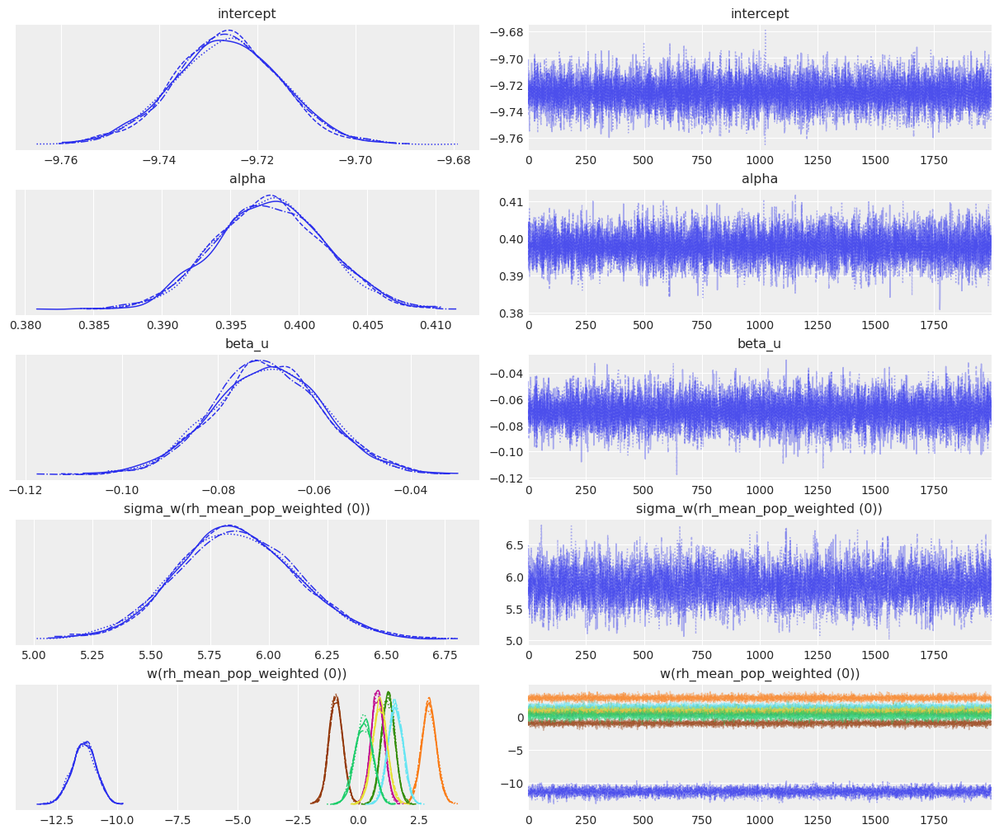

In [84]:
# 0.01
var_names = ['intercept', 'alpha', 'beta_u'] + [f'sigma_w({stat_name})' for stat_name in stat_names] + [f'w({stat_name})' for stat_name in stat_names]
display(az.summary(idata[model_name], var_names=var_names))
az.plot_trace(idata[model_name], var_names=var_names);

function mean across samples:  1.921985236118972e-15
-0.08447206303868933


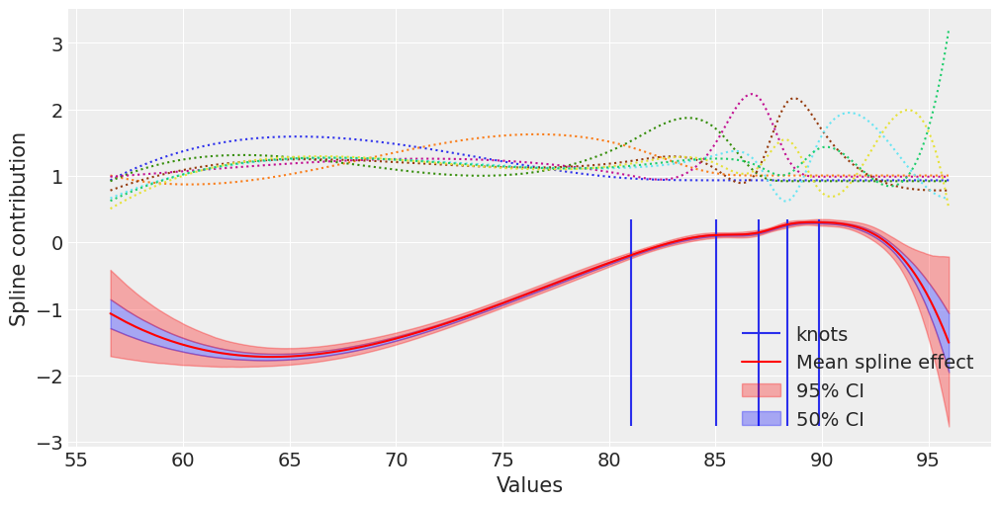

In [85]:
for stat_name in model_settings[model_name]['stat_names']:
    plot_spline(idata[model_name], f'w({stat_name})', f'sigma_w({stat_name})',
                model_B[model_name][stat_name], data[stat_name],
                knots=model_knot_list[model_name][stat_name],
                show_basis=True, basis_scale=8, invert_log=False)

In [86]:
# 0.01
var_names = ['intercept', 'alpha', 'beta_u'] + [f'sigma_w({stat_name})' for stat_name in stat_names] + [f'w({stat_name})' for stat_name in stat_names]
az.rcParams["plot.max_subplots"] = 200
ax = az.plot_pair(idata[model_name], var_names=var_names, textsize=20, divergences=True)

for i in range(ax.shape[0]):
    # Left-hand side (row labels / y-axis labels)
    ax[i, 0].yaxis.label.set_rotation(0)  # e.g., vertical left labels
    ax[i, 0].yaxis.label.set_ha('right')  # horizontal alignment

for j in range(ax.shape[1]):
    # Top (column labels / x-axis labels)
    ax[0, j].xaxis.label.set_rotation(45)  # e.g., rotate top labels
    ax[0, j].xaxis.label.set_ha('right')

/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/stats/stats.py:1652: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/stats/stats.py:782: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 8000 posterior samples and 24107 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -83002.68   345.43
p_loo       34.92        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     24106  100.0%
   (0.70, 1]   (bad)          0    0.0%
   (1, Inf)   (very bad)     1    0.0%

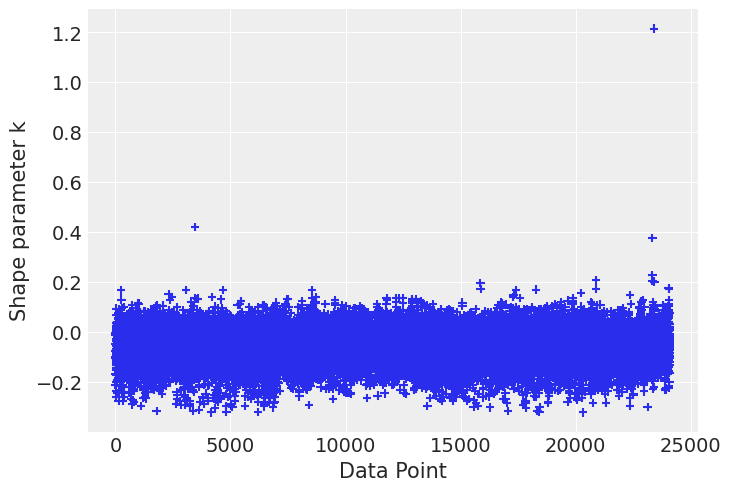

In [87]:
eval_waic[model_name] = az.waic(idata[model_name])

eval_psis_loo_elpd[model_name] = az.loo(idata[model_name])
az.plot_khat(eval_psis_loo_elpd[model_name])
eval_psis_loo_elpd[model_name]

---
# Variational Inference

In [49]:
idata_vi = {}
mean_field = {}

In [50]:
model[model_name], model_B[model_name], model_knot_list[model_name] = build_model(**model_settings[model_name])

In [52]:
with model[model_name]:
    # mean_field = pm.fit()
    mean_field[model_name] = pm.fit(100_000, obj_optimizer=pm.adam(learning_rate=1e-3), method='fullrank_advi',
        callbacks=[CheckParametersConvergence(diff="relative")])
idata_vi[model_name] = mean_field[model_name].sample(10_000)

Output()

Finished [100%]: Average Loss = 82,866


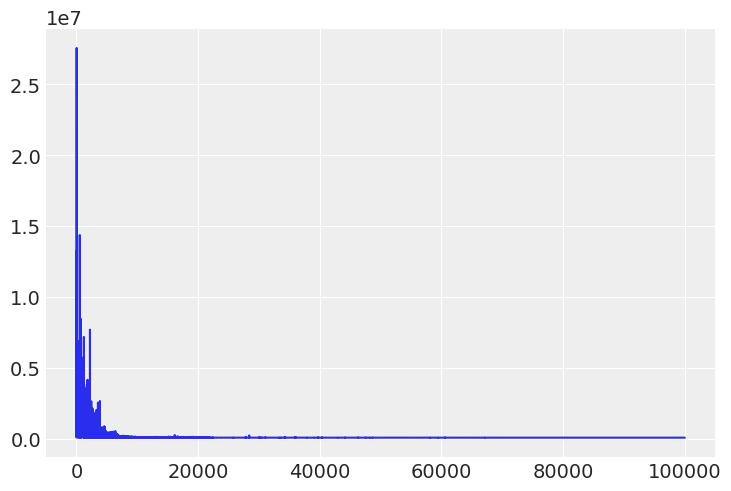

In [53]:
plt.plot(mean_field[model_name].hist);

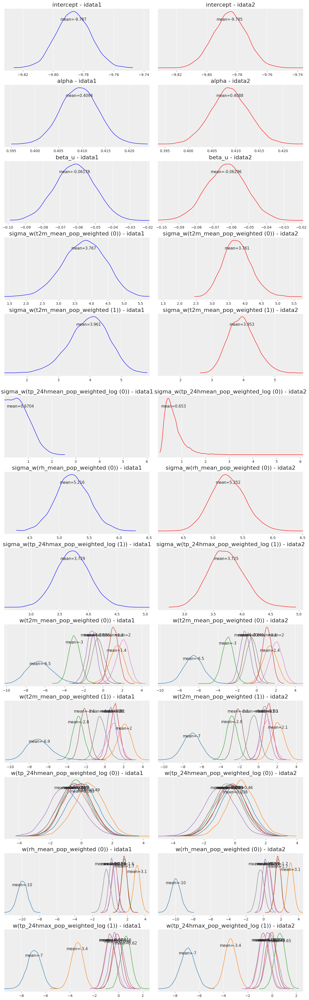

In [54]:
plot_posteriors_side_by_side(idata[model_name], idata_vi[model_name], var_names=var_names)

function mean across samples:  -2.762250138341839e-16
-0.08199651983272466


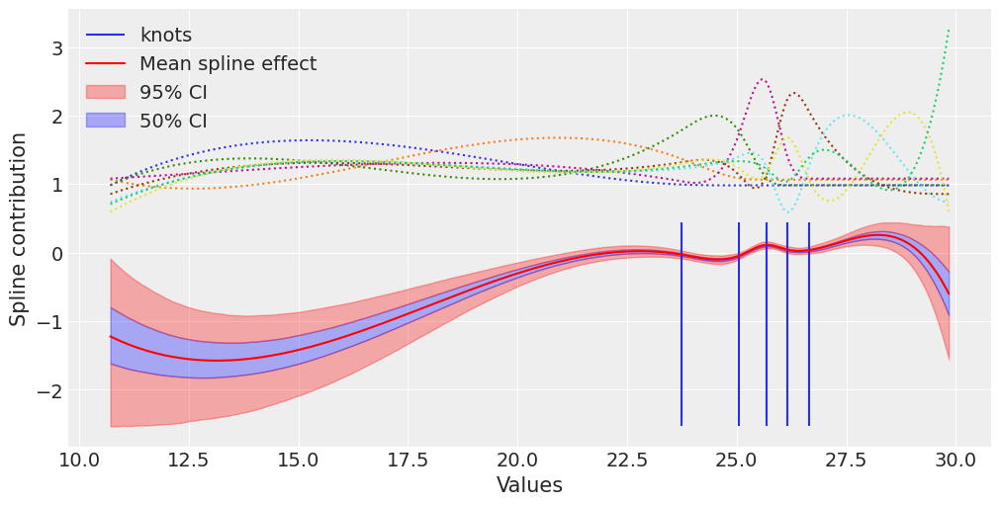

function mean across samples:  3.0732447343369693e-15
-0.08215028138121704


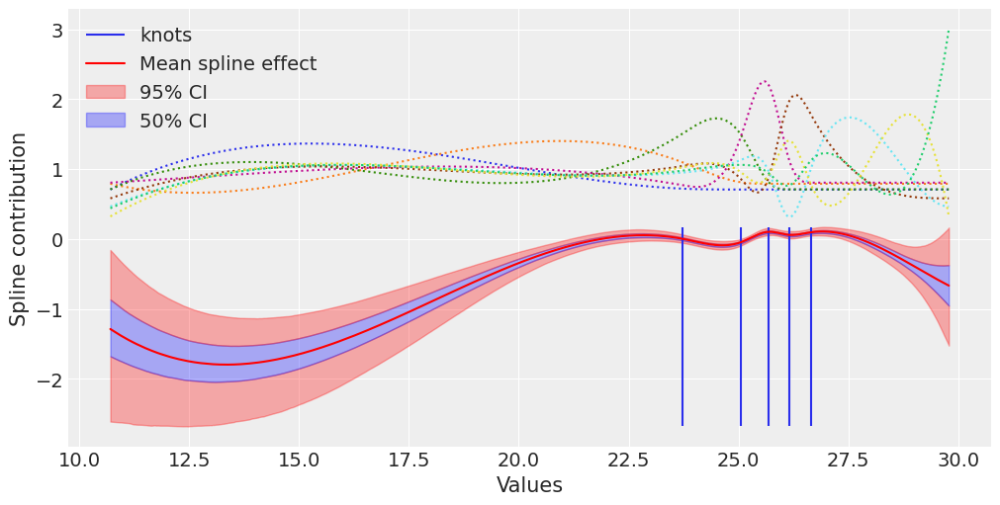

function mean across samples:  1.9142888442343876e-17
-0.0817857229484828


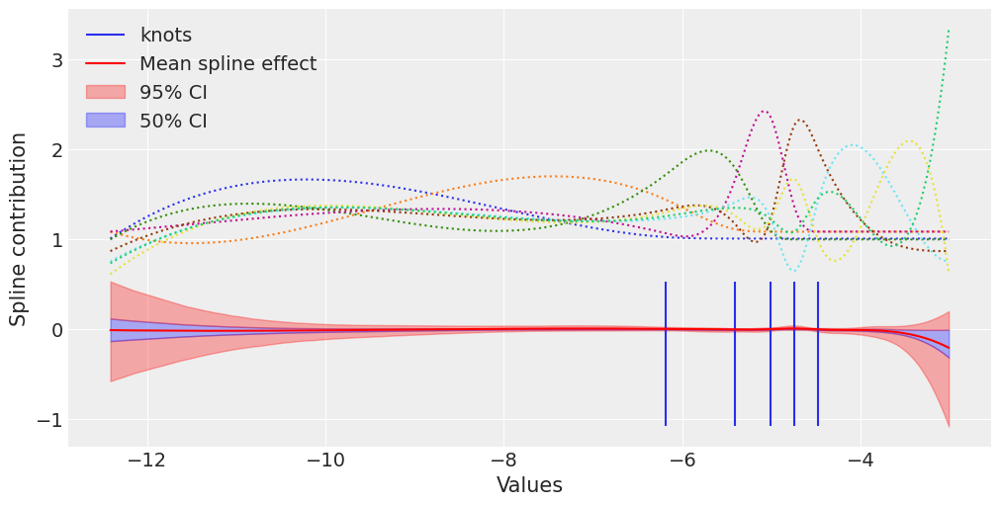

function mean across samples:  9.503685790658634e-16
-0.08447206303868933


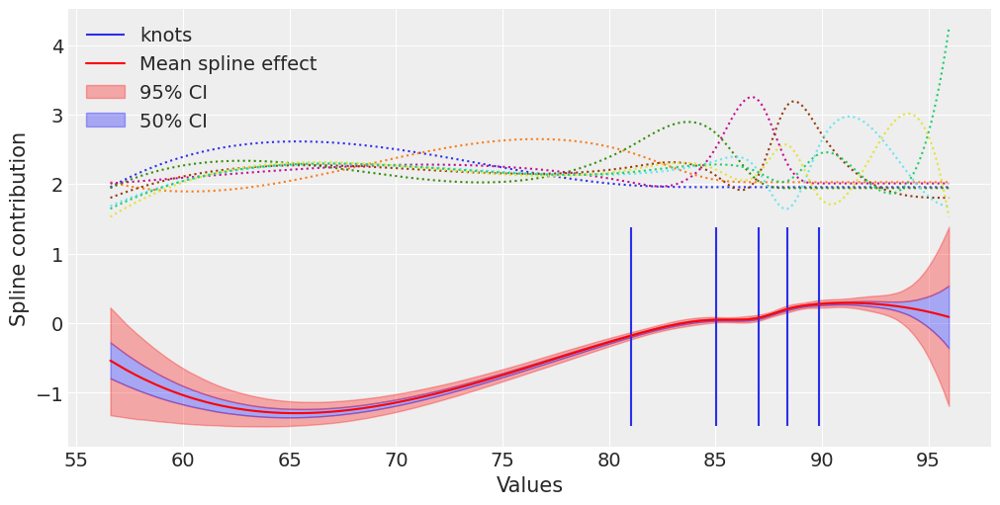

function mean across samples:  1.9702763224536193e-15
-0.0853936028219153


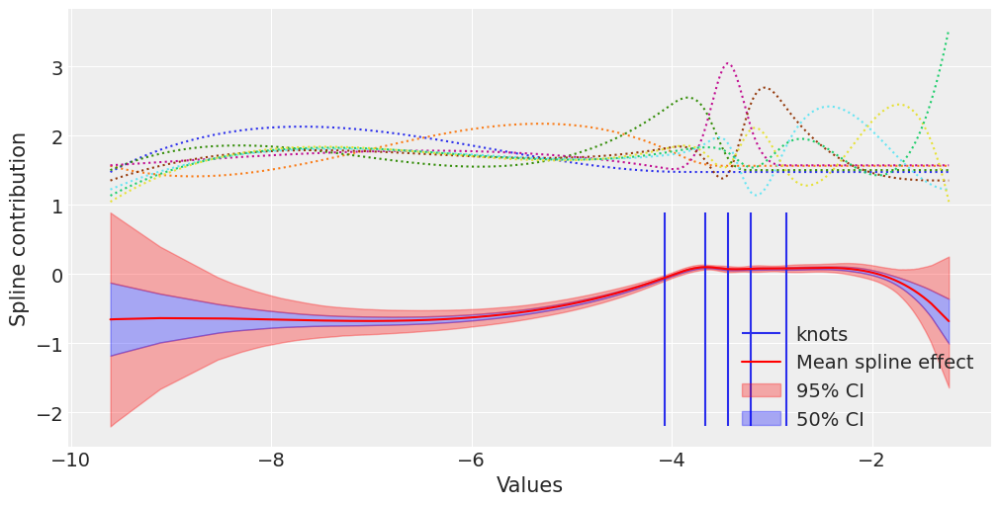

In [55]:
for stat_name in model_settings[model_name]['stat_names']:
    plot_spline(idata_vi[model_name], f'w({stat_name})', f'sigma_w({stat_name})',
                model_B[model_name][stat_name], data[stat_name],
                knots=model_knot_list[model_name][stat_name],
                show_basis=True, basis_scale=8, invert_log=False)

In [56]:
# 0.01
var_names = ['intercept', 'alpha', 'beta_u'] + [f'sigma_w({stat_name})' for stat_name in stat_names] + [f'w({stat_name})' for stat_name in stat_names]
az.rcParams["plot.max_subplots"] = 200
ax = az.plot_pair(idata_vi[model_name], var_names=var_names, textsize=20, divergences=True)

for i in range(ax.shape[0]):
    # Left-hand side (row labels / y-axis labels)
    ax[i, 0].yaxis.label.set_rotation(0)  # e.g., vertical left labels
    ax[i, 0].yaxis.label.set_ha('right')  # horizontal alignment

for j in range(ax.shape[1]):
    # Top (column labels / x-axis labels)
    ax[0, j].xaxis.label.set_rotation(45)  # e.g., rotate top labels
    ax[0, j].xaxis.label.set_ha('right')

/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/plots/pairplot.py:229: UserWarning: Divergences data not found, plotting without divergences. Make sure the sample method provides divergences data and that it is present in the `diverging` field of `sample_stats` or `sample_stats_prior` or set divergences=False
  warnings.warn(
/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/plots/backends/matplotlib/pairplot.py:223: UserWarning: rcParams['plot.max_subplots'] (200) is smaller than the number of resulting pair plots with these variables, generating only a 19x19 grid
  warnings.warn(


In [57]:
eval_waic_vi = {}
eval_psis_loo_elpd_vi = {}

In [58]:
with model[model_name]:
    pm.compute_log_likelihood(idata_vi[model_name], progressbar=False)

/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/stats/stats.py:1652: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/Users/lucaratzinger/.pyenv/versions/p-phylo-venv/lib/python3.14/site-packages/arviz/stats/stats.py:782: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 10000 posterior samples and 24107 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -82590.69   339.45
p_loo       75.18        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     24105  100.0%
   (0.70, 1]   (bad)          1    0.0%
   (1, Inf)   (very bad)     1    0.0%

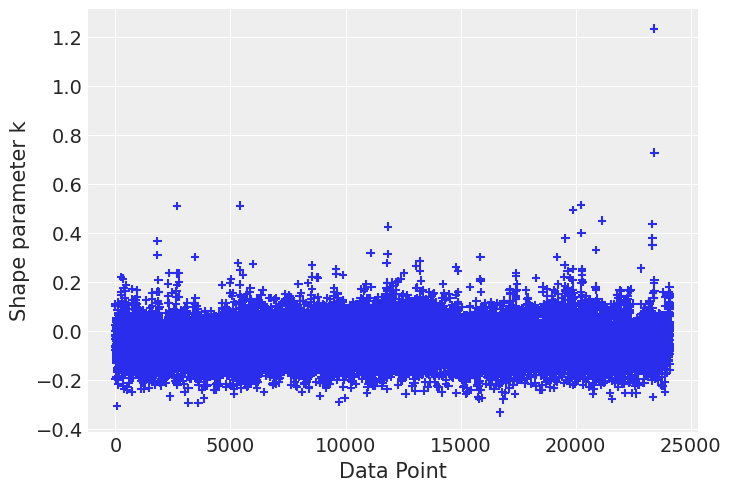

In [59]:
eval_waic_vi[model_name] = az.waic(idata_vi[model_name])

eval_psis_loo_elpd_vi[model_name] = az.loo(idata_vi[model_name])
az.plot_khat(eval_psis_loo_elpd_vi[model_name])
eval_psis_loo_elpd_vi[model_name]